# BetaVAE on CARS196 dataset

The <a href="https://www.tensorflow.org/datasets/catalog/cars196">cars196</a> dataset contains 16,185 images of 196 different types of cars, which
can be used to train a supervised learning system to determine the make and model of a vehicle in a photograph.

In [1]:
#%pip install -q tfds-nightly tensorflow matplotlib

In [2]:
import tensorflow as tf
import tensorflow_datasets as tfds

import numpy as np
from matplotlib import pyplot as plt
import model
from model import *
from methods import *

## Image size

In [3]:
height, width, depth = 64, 96, 1
batch_size = 32

## Download dataset

Let's get the data. Working on your machine, change `download` to `True` and change `DATA_DIR` to the name of the local directory you want to download the data to.

In [4]:
train_ds, test_ds = tfds.load('cars196', split=['train','test'], as_supervised=True, shuffle_files=True, download=True)

2022-06-10 15:40:53.501741: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Concatenate train and test.

In [5]:
tr_ds = train_ds.map(lambda x, y: x)
te_ds = test_ds.map(lambda x, y: x)
ds = tr_ds.concatenate(te_ds)

In [6]:
dataset = preprocessor(ds, height, width, batch_size)

In [7]:
for image_batch in dataset.take(1):
    images = image_batch.numpy()

i = 5
image = images[i,:,:,:]
img = np.expand_dims(image, 0)

### $\beta=0.001$

In [8]:
betafolder = "jobs/beta0_05/"

beta = 0.001
height, width, depth = 64, 96, 1
batch_size = 32
pad = 10 # padding for cropping
filters = [64,64,64,64]
kernels = [3,5,7,11]
hidden_dim = 1000
latent_dim = 100
image_size = (height, width, depth)
last_convdims = (int(height/(2**(len(filters)))),
                 int(width/(2**(len(filters)))))
epochs = 50

encoder = Encoder(filters=filters,kernels=kernels,hidden_dim=hidden_dim,latent_dim=latent_dim,image_shape=image_size)
decoder = Decoder(latent_dim=latent_dim,filters=filters,kernels=kernels,last_convdims=last_convdims, img_depth=depth)
checkpoint_path = betafolder + "checkpoints/latest_checkpoint"
vae0_001 = VAE(encoder, decoder, beta)
vae0_001.compile(optimizer=keras.optimizers.Adam())
vae0_001.load_weights(checkpoint_path)

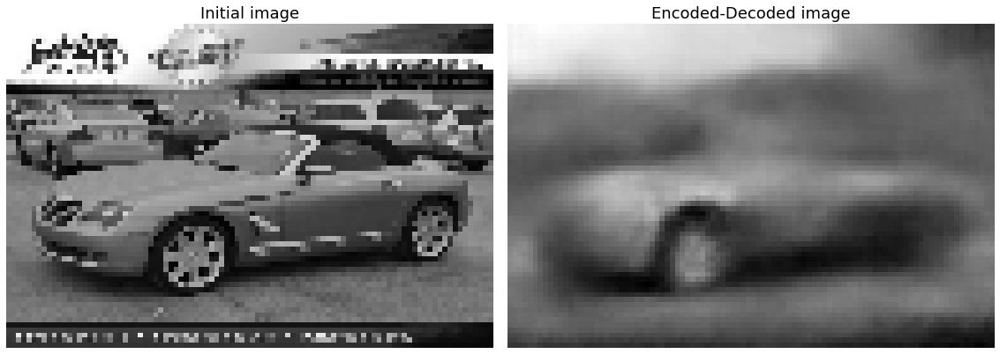

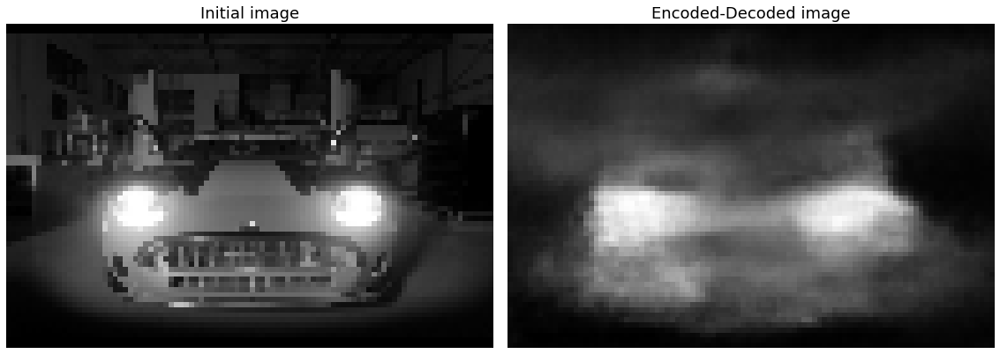

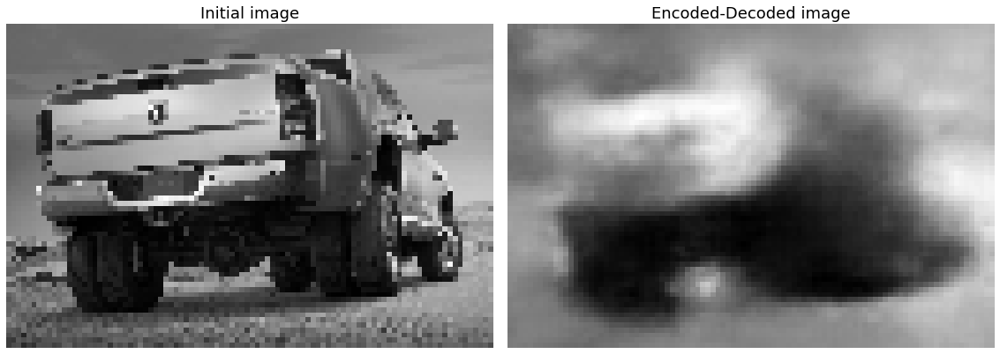

In [9]:
for i in [10,20,30]:
    show_reconstr_hor(images[i,:,:,0],vae_model=vae0_001)

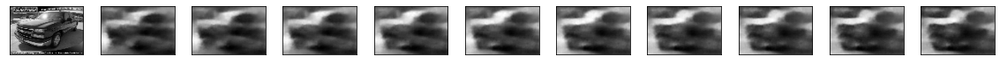

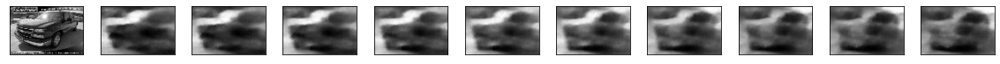

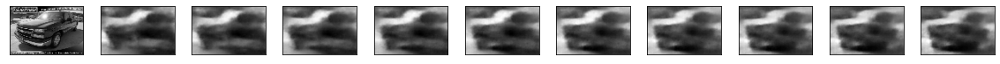

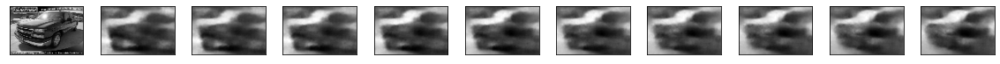

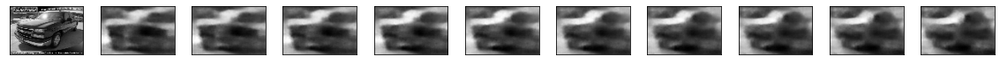

...

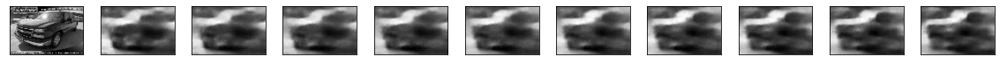

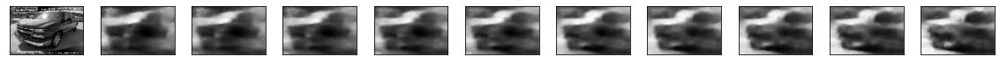

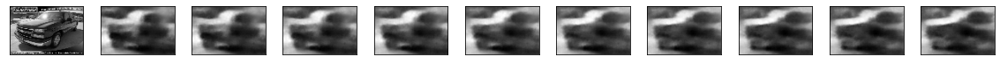

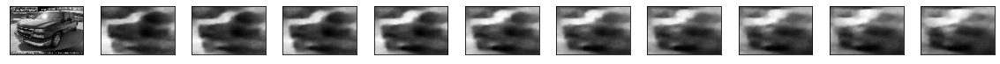

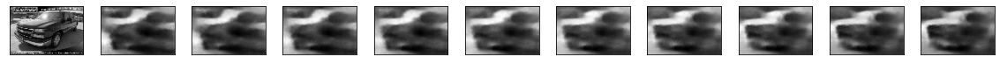

In [10]:
for i in range(0,100,5):
    generate_images2(vae_model=vae0_001, image=img, latent_dim=100, lat_feature=i, scale=5., N=10)

### $\beta=0.05$

In [11]:
betafolder = "jobs/beta0_05/"

beta = 0.05
height, width, depth = 64, 96, 1
batch_size = 32
pad = 10 # padding for cropping
filters = [64,64,64,64]
kernels = [3,5,7,11]
hidden_dim = 1000
latent_dim = 100
image_size = (height, width, depth)
last_convdims = (int(height/(2**(len(filters)))),
                 int(width/(2**(len(filters)))))
epochs = 50

encoder = Encoder(filters=filters,kernels=kernels,hidden_dim=hidden_dim,latent_dim=latent_dim,image_shape=image_size)
decoder = Decoder(latent_dim=latent_dim,filters=filters,kernels=kernels,last_convdims=last_convdims, img_depth=depth)
checkpoint_path = betafolder + "checkpoints/latest_checkpoint"
vae0_05 = VAE(encoder, decoder, beta)
vae0_05.compile(optimizer=keras.optimizers.Adam())
vae0_05.load_weights(checkpoint_path)

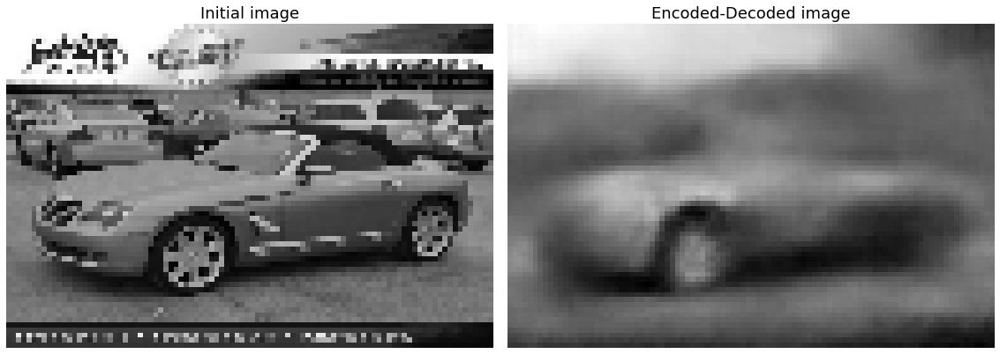

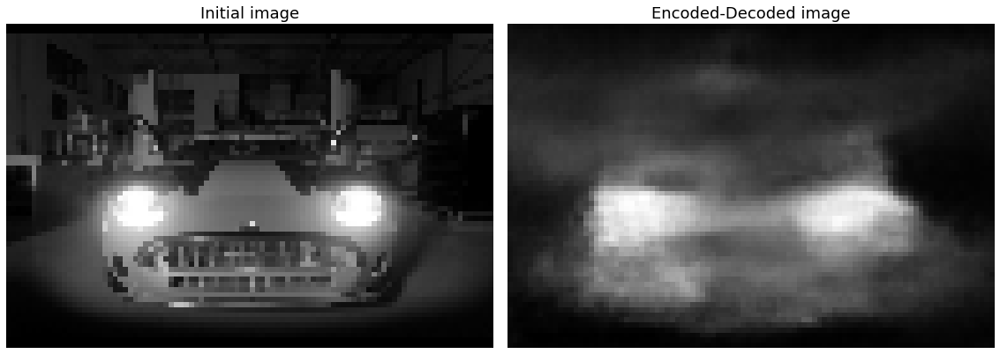

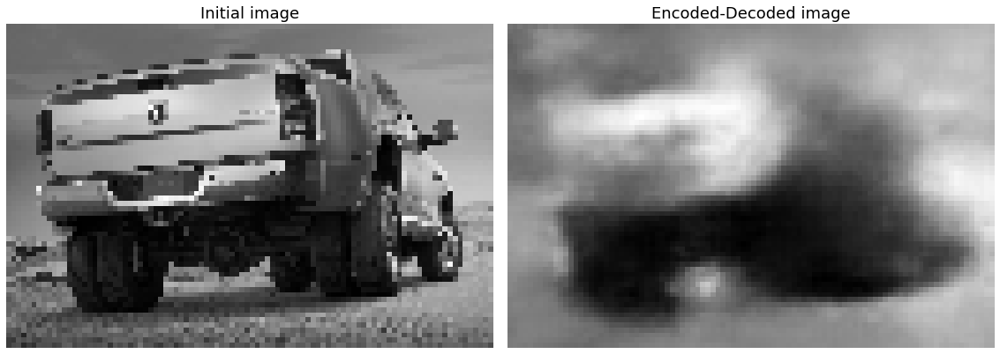

In [12]:
for i in [10,20,30]:
    show_reconstr_hor(images[i,:,:,0],vae_model=vae0_05)

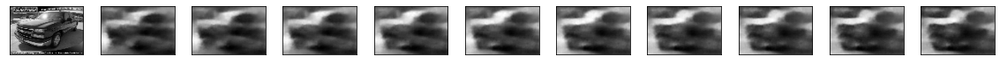

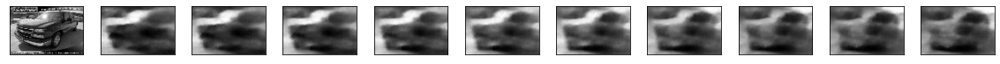

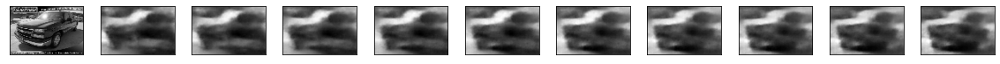

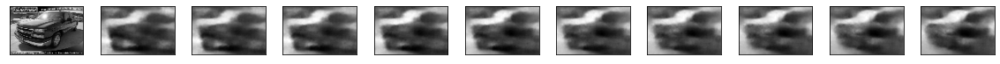

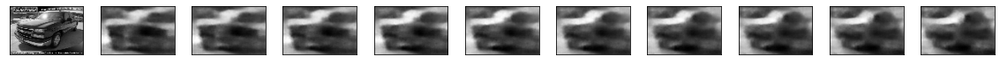

...

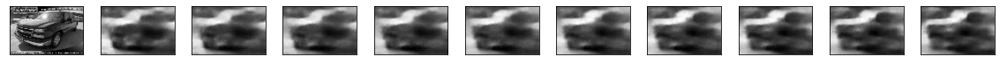

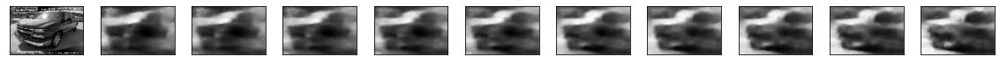

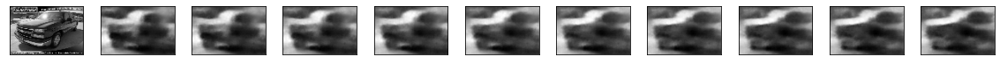

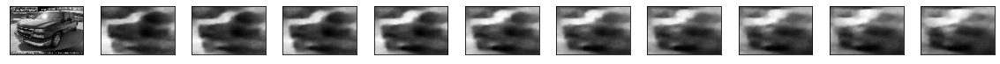

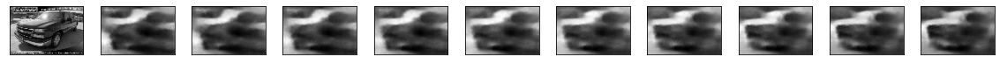

In [13]:
for i in range(0,100,5):
    generate_images2(vae_model=vae0_05, image=img, latent_dim=100, lat_feature=i, scale=5., N=10)

### $\beta=0.1$

In [14]:
betafolder = "jobs/beta0_1/"
beta = 0.1

height, width, depth = 64, 96, 1
batch_size = 32

filters = [64,64,64,64]
kernels = [3,5,7,11]
hidden_dim = 1000
latent_dim = 100
image_size = (height, width, depth)
last_convdims = (int(height/(2**(len(filters)))),
                 int(width/(2**(len(filters)))))
epochs = 50

encoder = Encoder(filters=filters,kernels=kernels,hidden_dim=hidden_dim,latent_dim=latent_dim,image_shape=image_size)
decoder = Decoder(latent_dim=latent_dim,filters=filters,kernels=kernels,last_convdims=last_convdims, img_depth=depth)
checkpoint_path = betafolder + "checkpoints/latest_checkpoint"
vae0_1 = VAE(encoder, decoder, beta)
vae0_1.compile(optimizer=keras.optimizers.Adam())
vae0_1.load_weights(checkpoint_path)

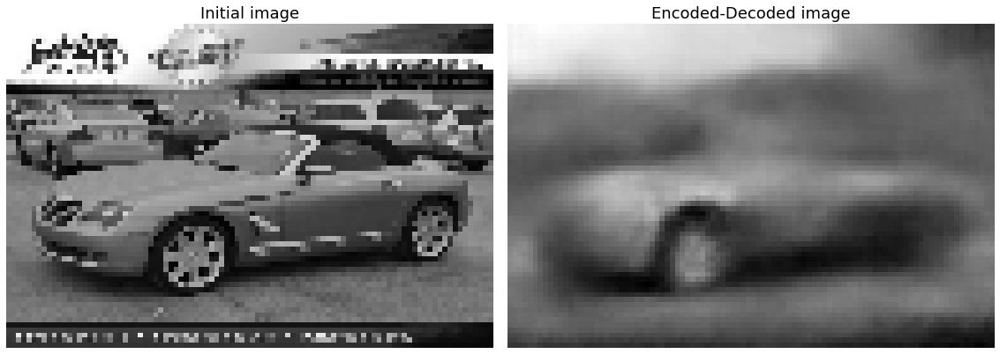

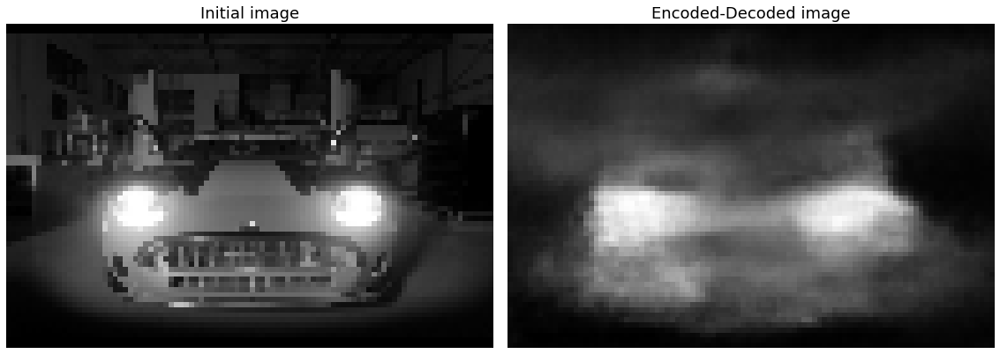

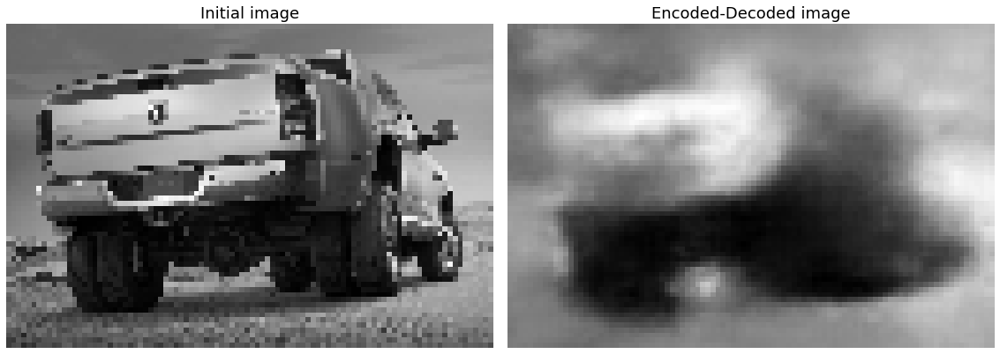

In [15]:
for i in [10,20,30]:
    show_reconstr_hor(images[i,:,:,0],vae_model=vae0_1)

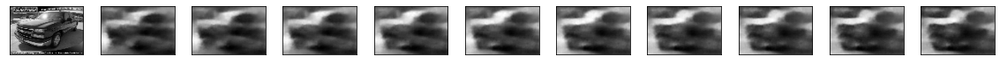

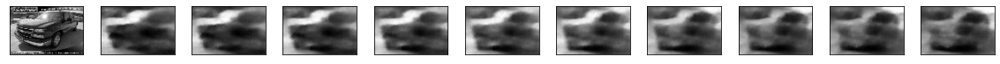

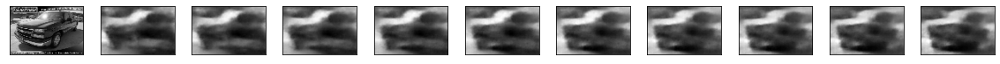

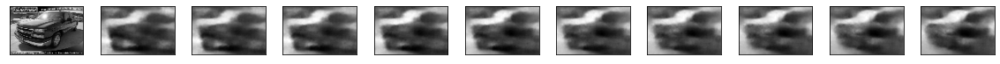

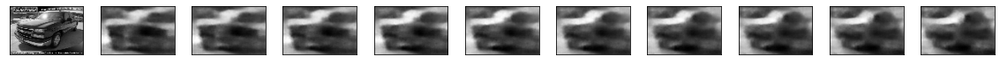

...

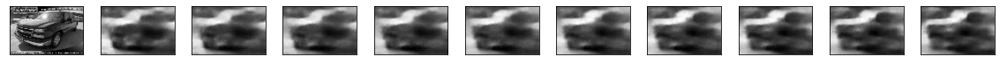

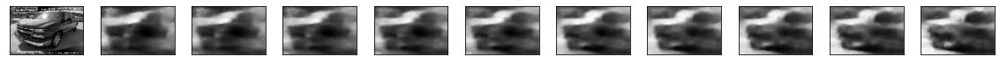

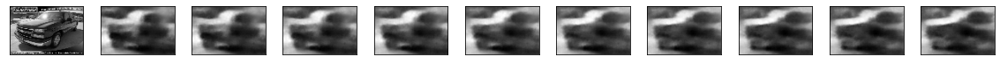

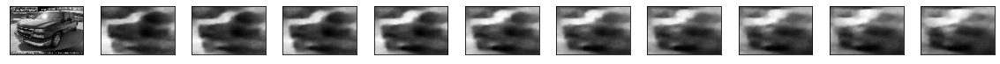

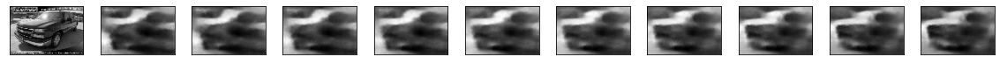

In [16]:
for i in range(0,100,5):
    generate_images2(vae_model=vae0_1, image=img, latent_dim=100, lat_feature=i, scale=5., N=10)

### $\beta=1$

In [17]:
betafolder = "jobs/beta1/"
beta = 1.

height, width, depth = 64, 96, 1
batch_size = 32

filters = [64,64,64,64]
kernels = [3,5,7,11]
hidden_dim = 1000
latent_dim = 100
image_size = (height, width, depth)
last_convdims = (int(height/(2**(len(filters)))),
                 int(width/(2**(len(filters)))))
epochs = 50

encoder = Encoder(filters=filters,kernels=kernels,hidden_dim=hidden_dim,latent_dim=latent_dim,image_shape=image_size)
decoder = Decoder(latent_dim=latent_dim,filters=filters,kernels=kernels,last_convdims=last_convdims, img_depth=depth)
checkpoint_path = betafolder + "checkpoints/latest_checkpoint"
vae1 = VAE(encoder, decoder, beta)
vae1.compile(optimizer=keras.optimizers.Adam())
vae1.load_weights(checkpoint_path)

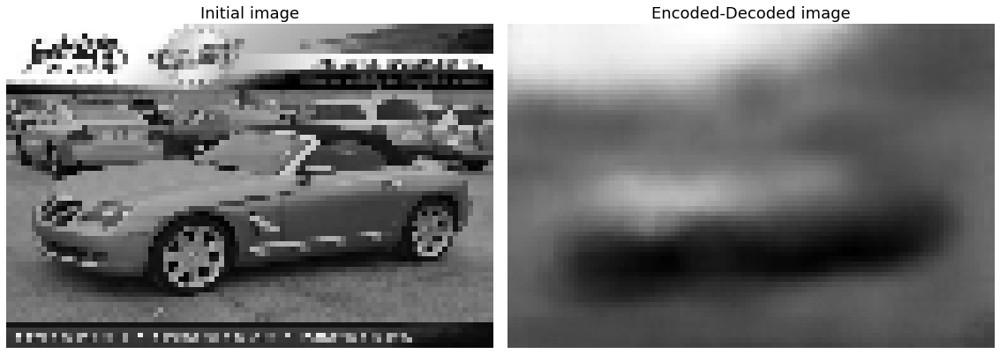

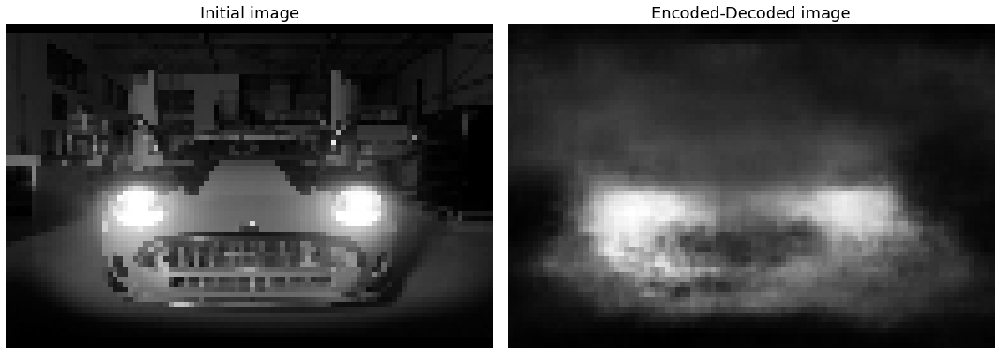

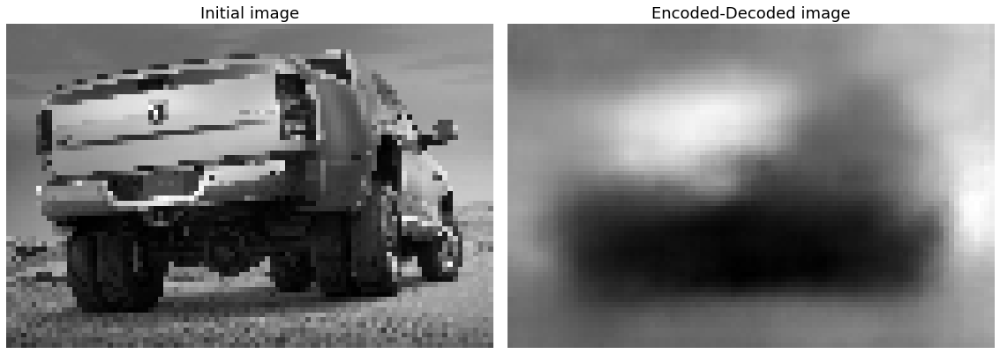

In [18]:
for i in [10,20,30]:
    show_reconstr_hor(images[i,:,:,0],vae_model=vae1)

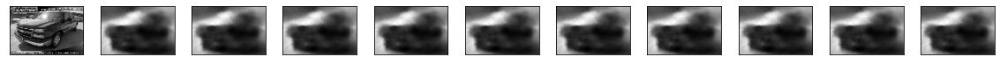

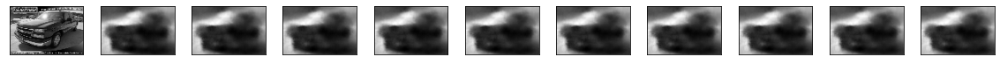

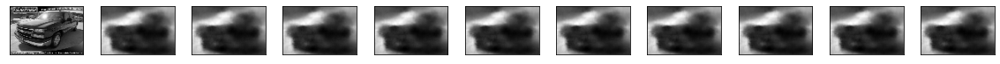

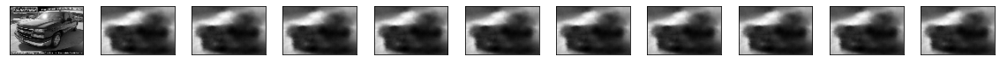

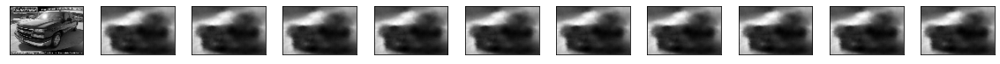

...

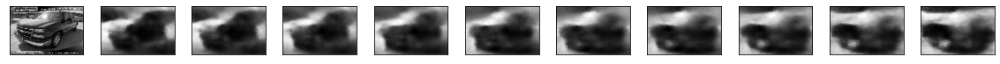

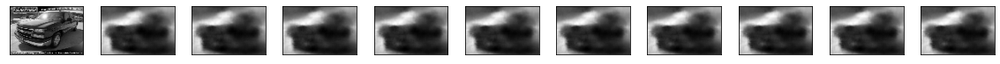

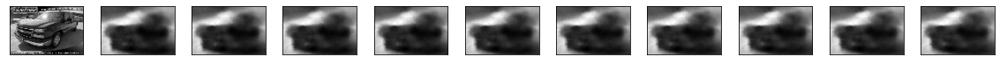

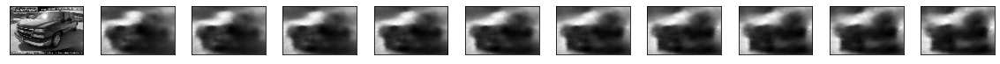

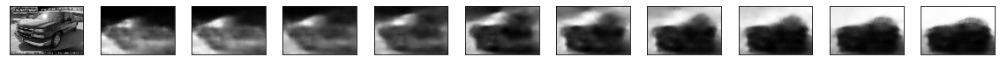

In [19]:
for i in range(0,100,5):
    generate_images2(vae_model=vae1, image=img, latent_dim=100, lat_feature=i, scale=5., N=10)

### $\beta=1.1$

In [20]:
betafolder = "jobs/beta1_1/"
beta = 1.1

height, width, depth = 64, 96, 1
batch_size = 32

filters = [64,64,64,64]
kernels = [3,5,7,11]
hidden_dim = 1000
latent_dim = 100
image_size = (height, width, depth)
last_convdims = (int(height/(2**(len(filters)))),
                 int(width/(2**(len(filters)))))
epochs = 50

encoder = Encoder(filters=filters,kernels=kernels,hidden_dim=hidden_dim,latent_dim=latent_dim,image_shape=image_size)
decoder = Decoder(latent_dim=latent_dim,filters=filters,kernels=kernels,last_convdims=last_convdims, img_depth=depth)
checkpoint_path = betafolder + "checkpoints/latest_checkpoint"
vae1_1 = VAE(encoder, decoder, beta)
vae1_1.compile(optimizer=keras.optimizers.Adam())
vae1_1.load_weights(checkpoint_path)

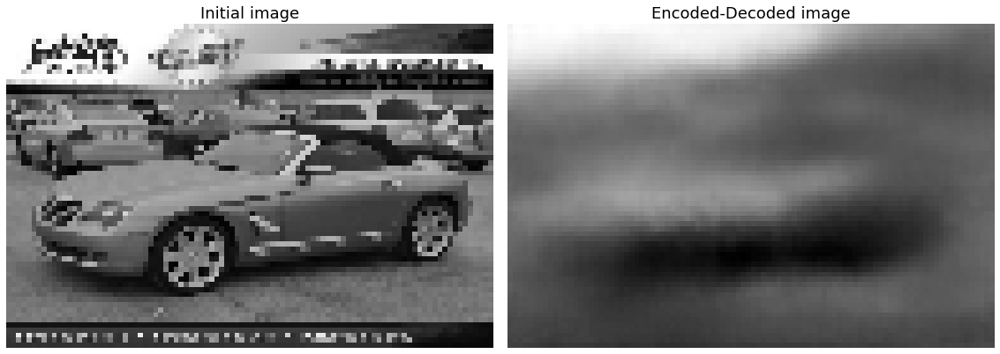

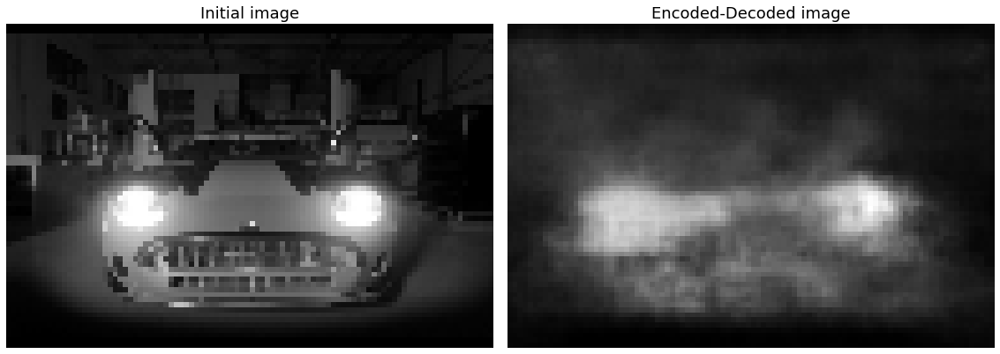

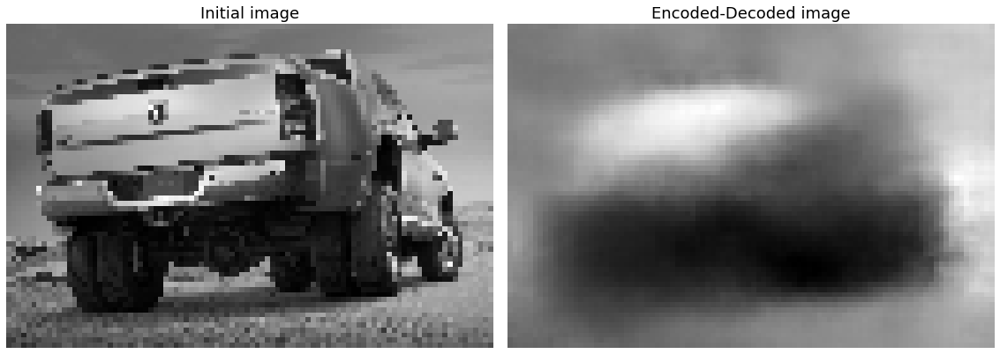

In [21]:
for i in [10,20,30]:
    show_reconstr_hor(images[i,:,:,0],vae_model=vae1_1)

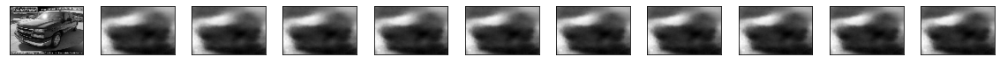

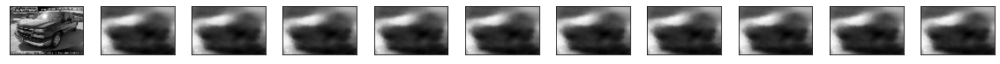

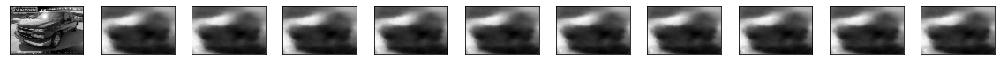

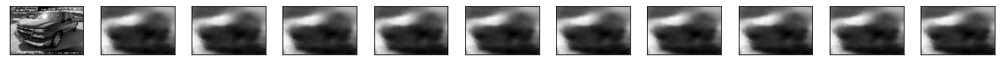

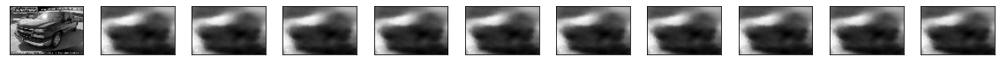

...

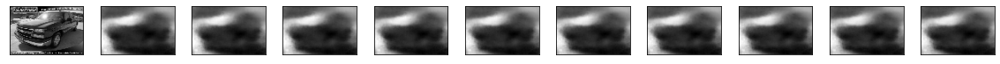

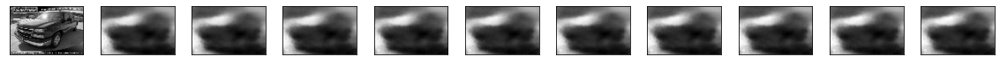

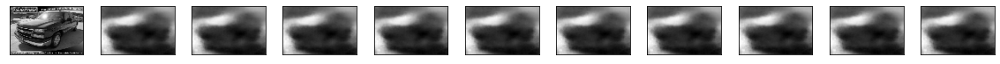

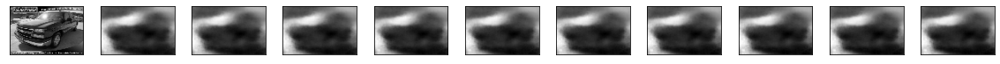

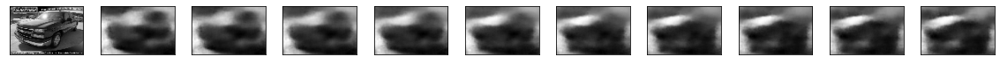

In [22]:
for i in range(0,100,5):
    generate_images2(vae_model=vae1_1, image=img, latent_dim=100, lat_feature=i, scale=5., N=10)

### $\beta=1.3$

In [23]:
betafolder = "jobs/beta1_3/"
beta = 1.3

height, width, depth = 64, 96, 1
batch_size = 32

filters = [64,64,64,64]
kernels = [3,5,7,11]
hidden_dim = 1000
latent_dim = 100
image_size = (height, width, depth)
last_convdims = (int(height/(2**(len(filters)))),
                 int(width/(2**(len(filters)))))
epochs = 50

encoder = Encoder(filters=filters,kernels=kernels,hidden_dim=hidden_dim,latent_dim=latent_dim,image_shape=image_size)
decoder = Decoder(latent_dim=latent_dim,filters=filters,kernels=kernels,last_convdims=last_convdims, img_depth=depth)
checkpoint_path = betafolder + "checkpoints/latest_checkpoint"
vae1_3 = VAE(encoder, decoder, beta)
vae1_3.compile(optimizer=keras.optimizers.Adam())
vae1_3.load_weights(checkpoint_path)

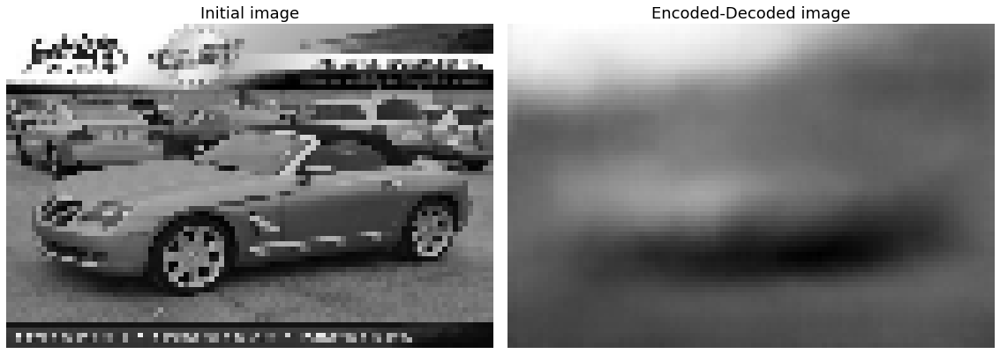

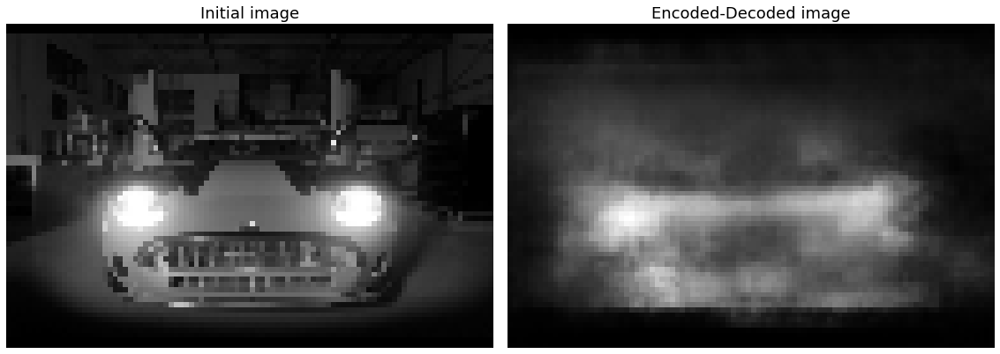

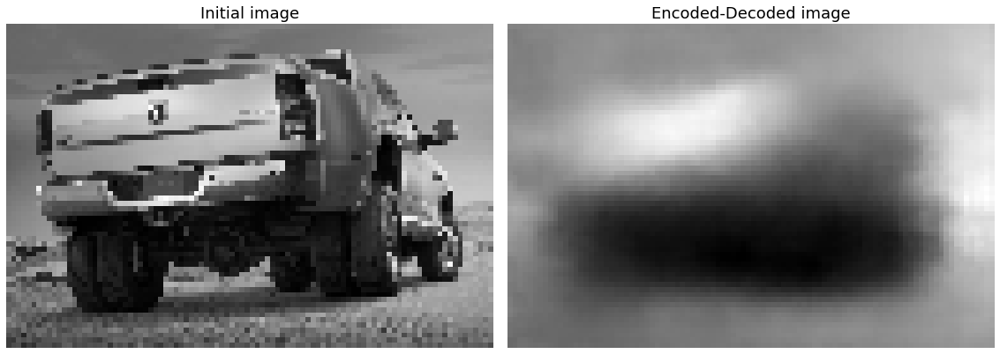

In [24]:
for i in [10,20,30]:
    show_reconstr_hor(images[i,:,:,0],vae_model=vae1_3)

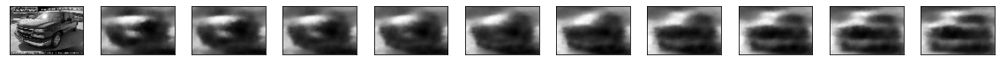

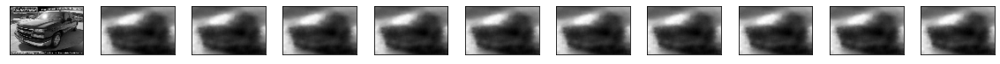

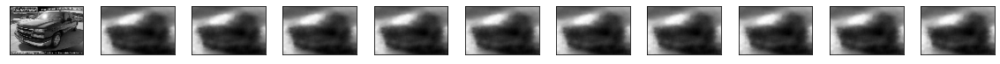

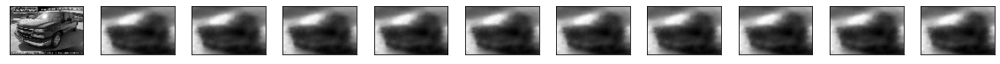

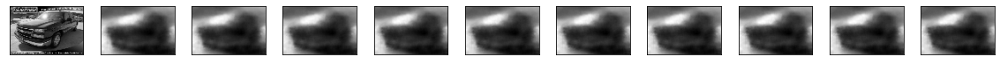

...

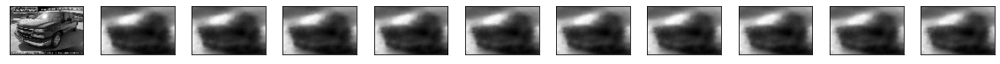

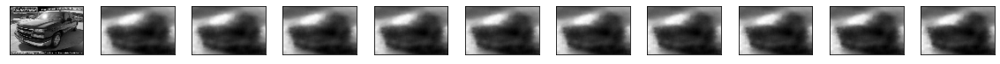

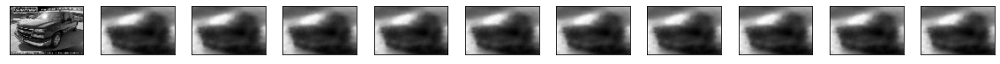

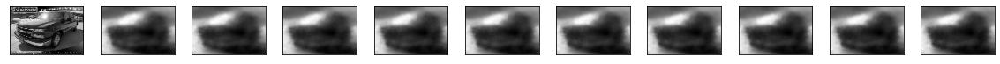

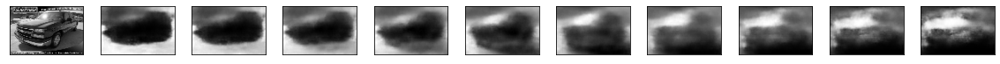

In [25]:
for i in range(0,100,5):
    generate_images2(vae_model=vae1_3, image=img, latent_dim=100, lat_feature=i, scale=5., N=10)

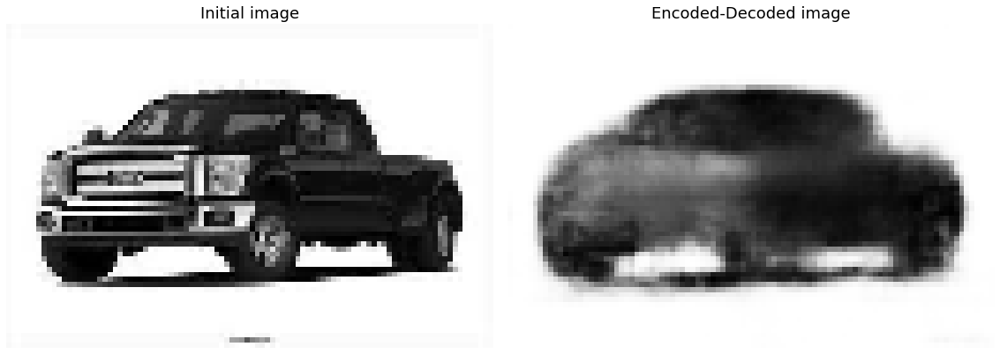

In [38]:
show_reconstr_hor(images[14,:,:,0],vae_model=vae1_3)

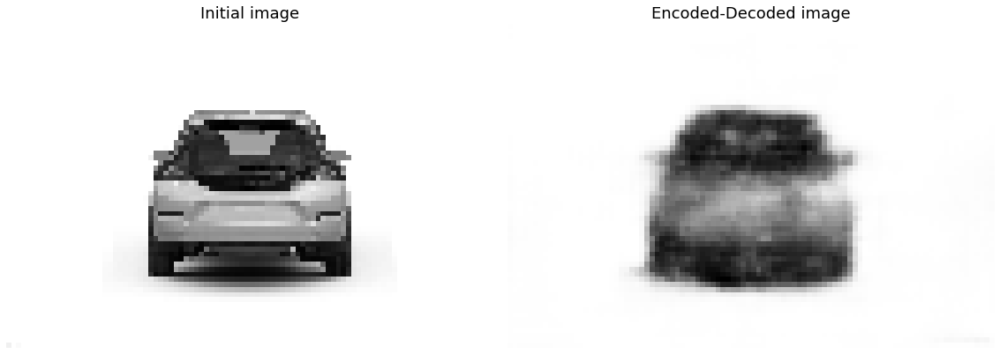

In [36]:
show_reconstr_hor(images[21,:,:,0],vae_model=vae1_3)

### $\beta=1.5$

In [26]:
betafolder = "jobs/beta1_5/"
beta = 1.5

height, width, depth = 64, 96, 1
batch_size = 32

filters = [64,64,64,64]
kernels = [3,5,7,11]
hidden_dim = 1000
latent_dim = 100
image_size = (height, width, depth)
last_convdims = (int(height/(2**(len(filters)))),
                 int(width/(2**(len(filters)))))
epochs = 50

encoder = Encoder(filters=filters,kernels=kernels,hidden_dim=hidden_dim,latent_dim=latent_dim,image_shape=image_size)
decoder = Decoder(latent_dim=latent_dim,filters=filters,kernels=kernels,last_convdims=last_convdims, img_depth=depth)
checkpoint_path = betafolder + "checkpoints/latest_checkpoint"
vae1_5 = VAE(encoder, decoder, beta)
vae1_5.compile(optimizer=keras.optimizers.Adam())
vae1_5.load_weights(checkpoint_path)

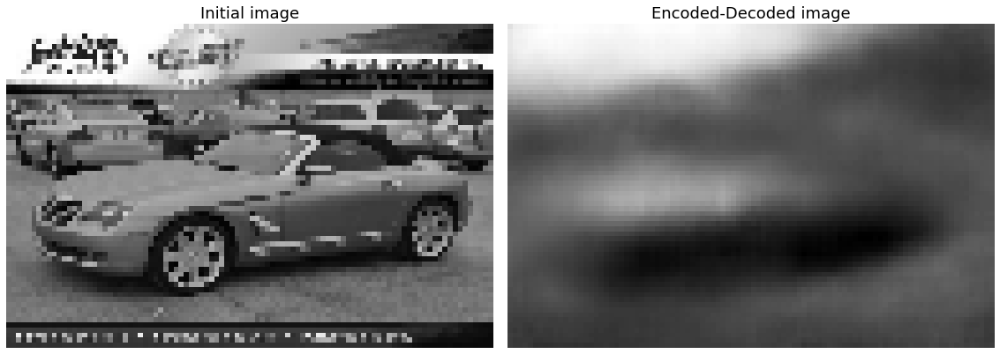

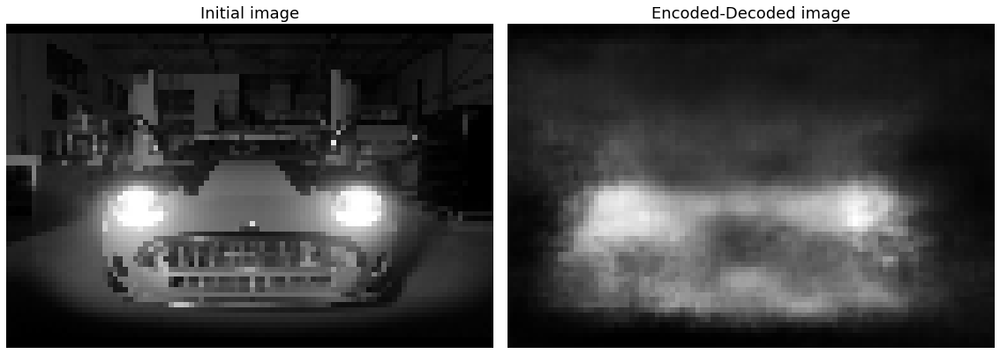

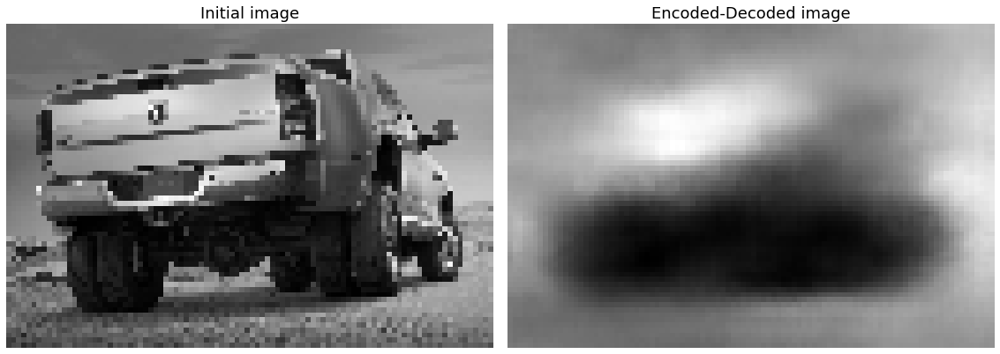

In [27]:
for i in [10,20,30]:
    show_reconstr_hor(images[i,:,:,0],vae_model=vae1_5)

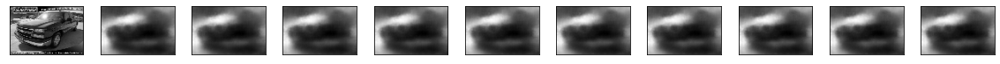

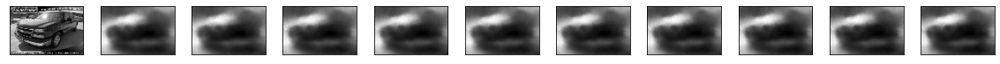

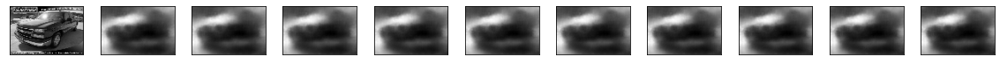

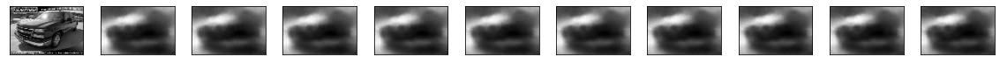

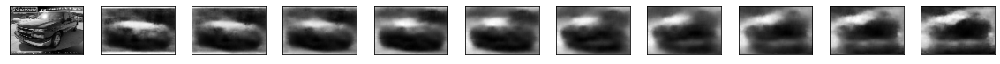

...

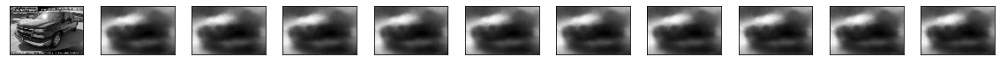

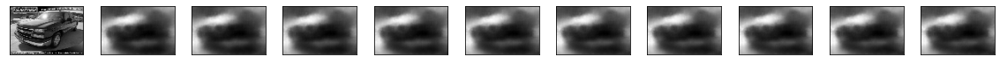

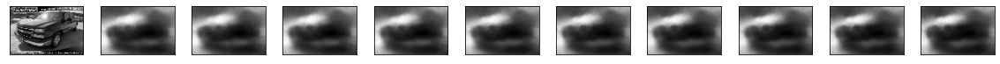

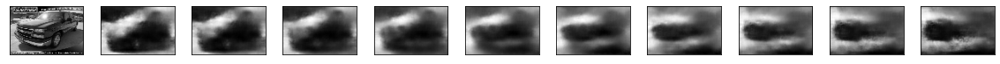

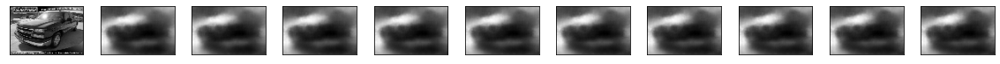

In [28]:
for i in range(0,100,5):
    generate_images2(vae_model=vae1_5, image=img, latent_dim=100, lat_feature=i, scale=5., N=10)

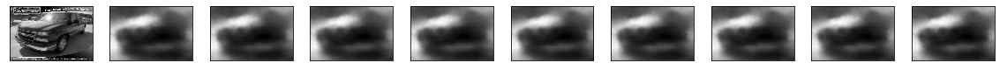

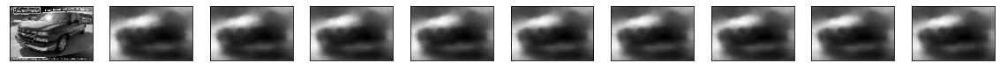

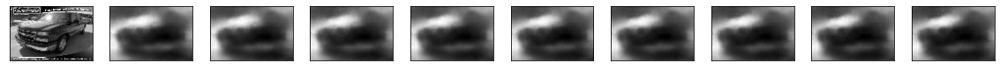

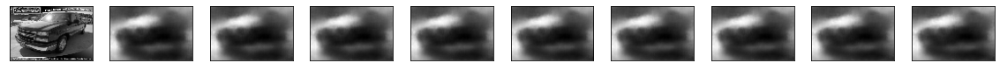

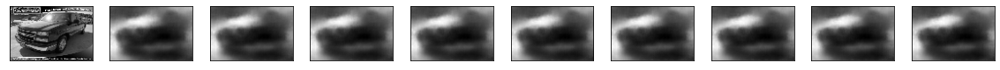

...

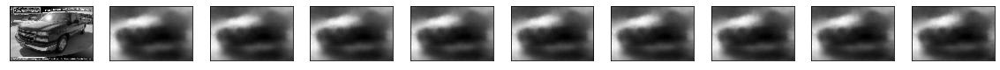

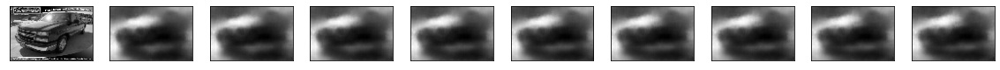

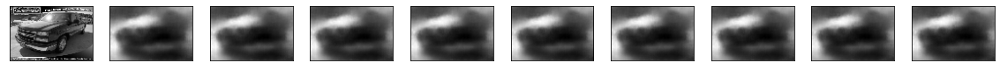

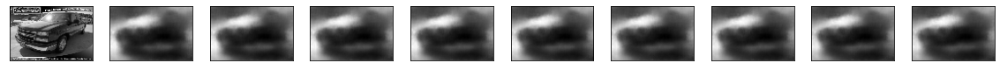

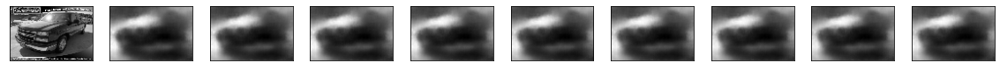

In [34]:
for i in range(0,100):
    generate_images2(vae_model=vae1_5, image=img, latent_dim=100, lat_feature=i, scale=5., N=9)

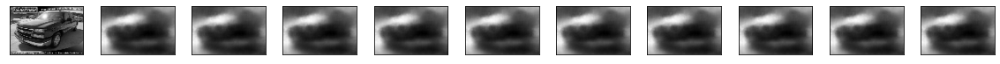

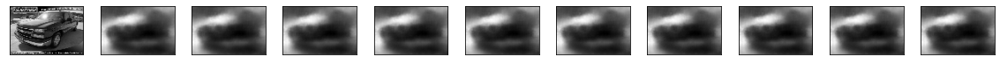

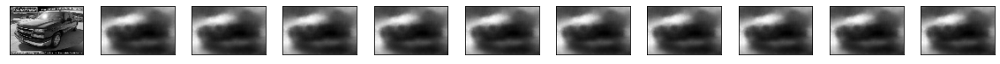

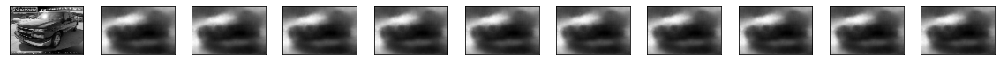

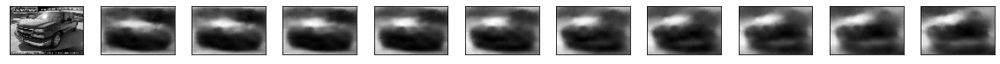

...

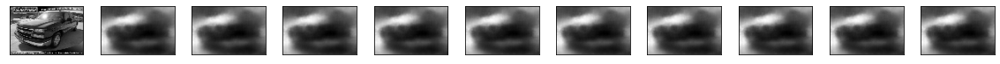

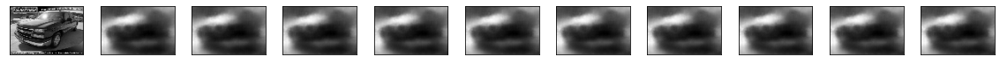

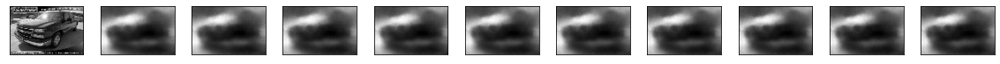

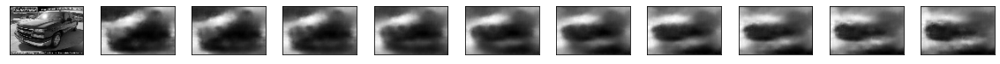

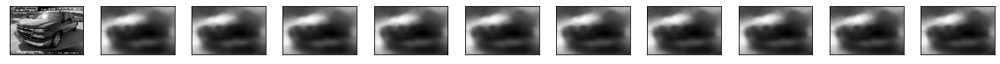

In [29]:
for i in range(0,100,5):
    generate_images2(vae_model=vae1_5, image=img, latent_dim=100, lat_feature=i, scale=3., N=10)

### Looking into method

In [30]:
image = img
vae_model = vae0_05
scale = 3.
N = 11
lat_feature = 10

""" Encode image """
z_mean,_,_ = vae_model.encoder.predict(image)

""" Sample given feature """
grid_x = np.linspace(-scale, scale, N)
samples = np.repeat(z_mean, N, axis=0)
samples[:, lat_feature] = grid_x
samples[:,:11]

array([[ 0.5040785 ,  2.0971928 , -1.0933236 , -1.0221803 ,  1.8708316 ,
        -1.9310629 , -0.7043836 ,  0.12603992, -2.277892  , -0.03070927,
        -3.        ],
       [ 0.5040785 ,  2.0971928 , -1.0933236 , -1.0221803 ,  1.8708316 ,
        -1.9310629 , -0.7043836 ,  0.12603992, -2.277892  , -0.03070927,
        -2.4       ],
       [ 0.5040785 ,  2.0971928 , -1.0933236 , -1.0221803 ,  1.8708316 ,
        -1.9310629 , -0.7043836 ,  0.12603992, -2.277892  , -0.03070927,
        -1.8       ],
       [ 0.5040785 ,  2.0971928 , -1.0933236 , -1.0221803 ,  1.8708316 ,
        -1.9310629 , -0.7043836 ,  0.12603992, -2.277892  , -0.03070927,
        -1.2       ],
       [ 0.5040785 ,  2.0971928 , -1.0933236 , -1.0221803 ,  1.8708316 ,
        -1.9310629 , -0.7043836 ,  0.12603992, -2.277892  , -0.03070927,
        -0.6       ],
       [ 0.5040785 ,  2.0971928 , -1.0933236 , -1.0221803 ,  1.8708316 ,
        -1.9310629 , -0.7043836 ,  0.12603992, -2.277892  , -0.03070927,
         0.   

In [31]:
samples.shape

(11, 100)

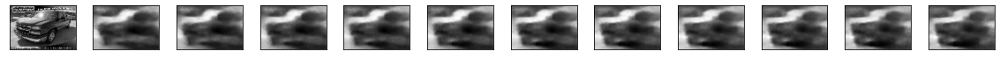

In [32]:

""" Generate new images """
dec_imgs = vae_model.decoder.predict(samples)

""" Plot images """
fig, axs = plt.subplots(nrows=1, ncols=N+1, figsize=(16, 4),
                        subplot_kw={'xticks': [], 'yticks': []})
for i,ax in enumerate(axs.flat):
    if i==0: ax.imshow(image[0,:,:,:],cmap='gray')
    else: ax.imshow(dec_imgs[i-1,:,:,:],cmap='gray')
plt.tight_layout()
plt.show()

### Other experiments

In [33]:
sample = np.zeros((1,100))
vae1_5.decoder.predict(sample)

array([[[[0.54637396],
         [0.549727  ],
         [0.55442774],
         ...,
         [0.55597246],
         [0.55766106],
         [0.54807365]],

        [[0.5463001 ],
         [0.54783547],
         [0.5480927 ],
         ...,
         [0.554348  ],
         [0.5547661 ],
         [0.5495785 ]],

        [[0.5413567 ],
         [0.54112697],
         [0.54051137],
         ...,
         [0.546004  ],
         [0.5491541 ],
         [0.5451895 ]],

        ...,

        [[0.5066353 ],
         [0.50517535],
         [0.5027838 ],
         ...,
         [0.5121889 ],
         [0.5154218 ],
         [0.508017  ]],

        [[0.505838  ],
         [0.505479  ],
         [0.50250405],
         ...,
         [0.5117662 ],
         [0.51485527],
         [0.50658375]],

        [[0.50181365],
         [0.5028549 ],
         [0.5001809 ],
         ...,
         [0.5066826 ],
         [0.5111952 ],
         [0.5051146 ]]]], dtype=float32)

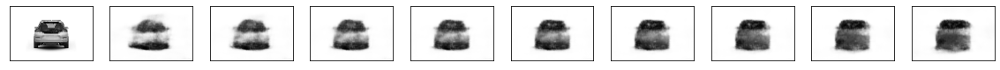

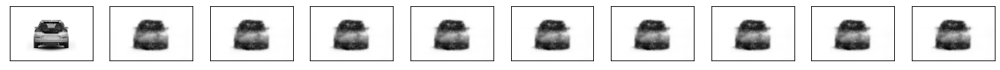

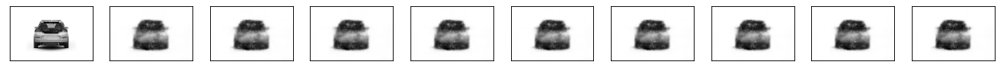

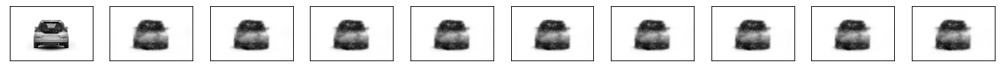

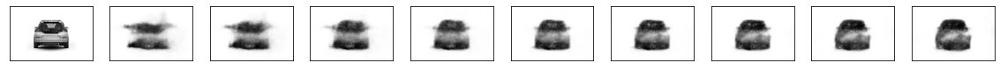

...

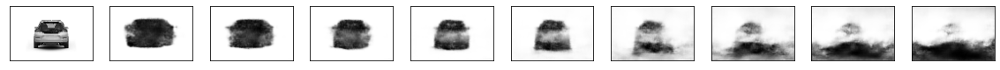

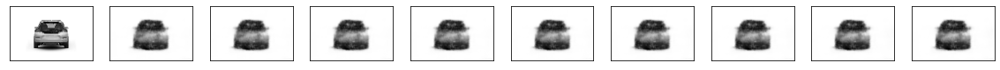

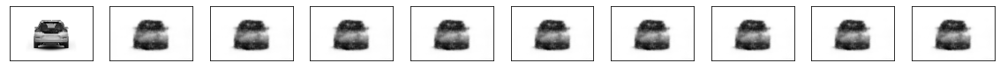

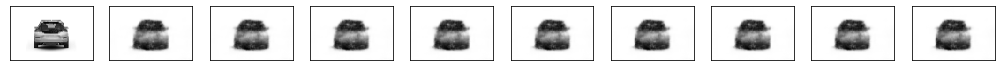

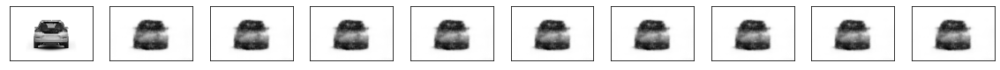

In [41]:
image = images[21,:,:,:]
img = np.expand_dims(image, 0)

for i in range(0,100):
    generate_images2(vae_model=vae1_3, image=img, latent_dim=100, lat_feature=i, scale=5., N=9)

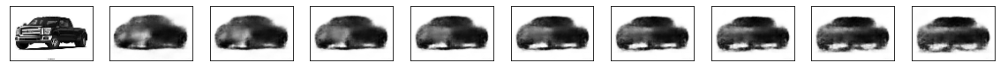

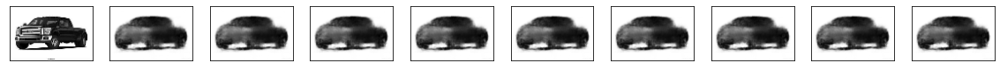

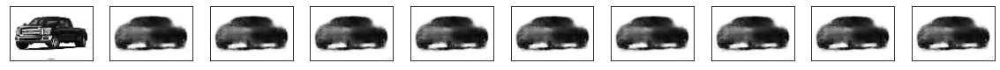

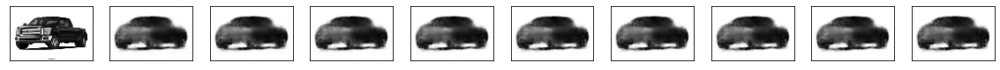

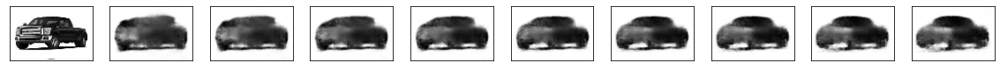

...

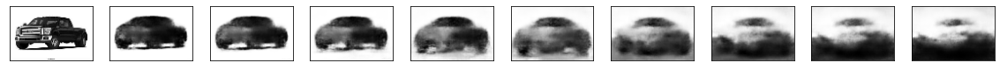

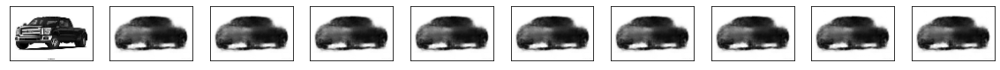

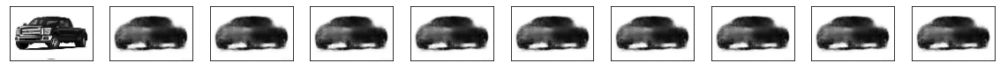

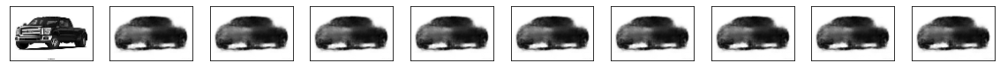

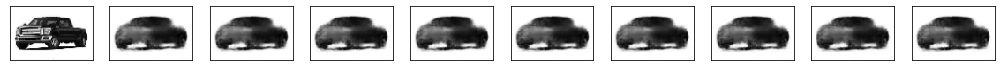

In [42]:
image = images[14,:,:,:]
img = np.expand_dims(image, 0)

for i in range(0,100):
    generate_images2(vae_model=vae1_3, image=img, latent_dim=100, lat_feature=i, scale=5., N=9)